# Decision Tree and Random Forest

APS failure at Scania trucks 
https://archive.ics.uci.edu/ml/datasets/APS+Failure+at+Scania+Trucks

Data is already split into train/test

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
% matplotlib inline

from sklearn.feature_selection import VarianceThreshold
from sklearn import tree
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn import preprocessing
from sklearn import ensemble

from IPython.display import Image

import pydotplus

# For timing the functions
import time

In [2]:
# Read in the train and test datasets
df_train = pd.read_csv('aps_failure_training_set.csv', skiprows=20, na_values='na')
df_test = pd.read_csv('aps_failure_test_set.csv', skiprows=20, na_values='na')

df_train['class'] = np.where(df_train['class'] == 'neg', 0, 1)
df_test['class'] = np.where(df_test['class'] == 'neg', 0, 1)

print(df_train['class'].sum())

1000


In [3]:
df_train.head()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,0,76698,NaN,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,...,1240520.0,493384.0,721044.0,469792.0,339156.0,157956.0,73224.0,0.0,0.0,0.0
1,0,33058,NaN,0.000000e+00,NaN,0.0,0.0,0.0,0.0,0.0,...,421400.0,178064.0,293306.0,245416.0,133654.0,81140.0,97576.0,1500.0,0.0,0.0
2,0,41040,NaN,2.280000e+02,100.0,0.0,0.0,0.0,0.0,0.0,...,277378.0,159812.0,423992.0,409564.0,320746.0,158022.0,95128.0,514.0,0.0,0.0
3,0,12,0.0,7.000000e+01,66.0,0.0,10.0,0.0,0.0,0.0,...,240.0,46.0,58.0,44.0,10.0,0.0,0.0,0.0,4.0,32.0
4,0,60874,NaN,1.368000e+03,458.0,0.0,0.0,0.0,0.0,0.0,...,622012.0,229790.0,405298.0,347188.0,286954.0,311560.0,433954.0,1218.0,0.0,0.0


In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60000 entries, 0 to 59999
Columns: 171 entries, class to eg_000
dtypes: float64(169), int64(2)
memory usage: 78.3 MB


In [5]:
df_train.dtypes.head()

class       int64
aa_000      int64
ab_000    float64
ac_000    float64
ad_000    float64
dtype: object

In [6]:
df_train.describe()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
count,60000.000000,6.000000e+04,13671.000000,5.666500e+04,4.513900e+04,57500.000000,57500.000000,5.932900e+04,5.932900e+04,5.932900e+04,...,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,57276.000000,57277.000000
mean,0.016667,5.933650e+04,0.713189,3.560143e+08,1.906206e+05,6.819130,11.006817,2.216364e+02,9.757223e+02,8.606015e+03,...,4.454897e+05,2.111264e+05,4.457343e+05,3.939462e+05,3.330582e+05,3.462714e+05,1.387300e+05,8.388915e+03,0.090579,0.212756
std,0.128020,1.454301e+05,3.478962,7.948749e+08,4.040441e+07,161.543373,209.792592,2.047846e+04,3.420053e+04,1.503220e+05,...,1.155540e+06,5.433188e+05,1.168314e+06,1.121044e+06,1.069160e+06,1.728056e+06,4.495100e+05,4.747043e+04,4.368855,8.830641
min,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,0.000000,8.340000e+02,0.000000,1.600000e+01,2.400000e+01,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,...,2.936000e+03,1.166000e+03,2.700000e+03,3.584000e+03,5.120000e+02,1.100000e+02,0.000000e+00,0.000000e+00,0.000000,0.000000
50%,0.000000,3.077600e+04,0.000000,1.520000e+02,1.260000e+02,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,...,2.337960e+05,1.120860e+05,2.215180e+05,1.899880e+05,9.243200e+04,4.109800e+04,3.812000e+03,0.000000e+00,0.000000,0.000000
75%,0.000000,4.866800e+04,0.000000,9.640000e+02,4.300000e+02,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,...,4.383960e+05,2.182320e+05,4.666140e+05,4.032220e+05,2.750940e+05,1.678140e+05,1.397240e+05,2.028000e+03,0.000000,0.000000
max,1.000000,2.746564e+06,204.000000,2.130707e+09,8.584298e+09,21050.000000,20070.000000,3.376892e+06,4.109372e+06,1.055286e+07,...,7.793393e+07,3.775839e+07,9.715238e+07,5.743524e+07,3.160781e+07,1.195801e+08,1.926740e+07,3.810078e+06,482.000000,1146.000000


In [7]:
df_train.isna().sum().sort_values(ascending=False).head(15)

br_000    49264
bq_000    48722
bp_000    47740
bo_000    46333
cr_000    46329
ab_000    46329
bn_000    44009
bm_000    39549
bl_000    27277
bk_000    23034
cf_000    14861
co_000    14861
cg_000    14861
ch_000    14861
ad_000    14861
dtype: int64

In [8]:
features = df_train.columns[1:]
target = df_train.columns[0]


# Could change this to be df.drop_na(axis=1, thresh=59000)
for x in range(len(features)):
    if df_train[features[x]].isna().sum() > 1000:
        df_train.drop(columns=features[x], inplace=True)
        df_test.drop(columns=features[x], inplace=True)

print('There are {} columns remaining in the data frame'.format(len(df_train.columns)))

df_train.dropna(axis=0, inplace=True)
df_test.dropna(axis=0, inplace=True)

There are 101 columns remaining in the data frame


In [9]:
df_train.isna().sum().sort_values(ascending=False).head(5)

ee_009    0
az_002    0
ay_002    0
ay_003    0
ay_004    0
dtype: int64

In [10]:
features = df_train.columns[1:]

X = df_train[features]
Y = df_train[target]

## Perform feature selection

In [11]:
# Create a Variance Threshold object with threshold of 0.5
sel = VarianceThreshold(threshold=.5)
sel.fit_transform(X)

mask = sel.get_support()
new_features = X.columns[mask]

print(len(new_features))
print(mask)

99
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True False  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True]


In [12]:
# Initialize and train our tree.
decision_tree = tree.DecisionTreeClassifier(
    criterion='entropy',
    max_features=1,
    max_depth=20,
)

decision_tree.fit(X[new_features], Y)

# Render our tree.
dot_data = tree.export_graphviz(
    decision_tree, out_file=None,
    feature_names=new_features,
    class_names=['Working', 'Not Working'],
    filled=True
)
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

In [26]:
# Time running the function with the tree
start_time = time.time()
cross_val_score(decision_tree, X[new_features], Y, cv=10)
print("--- {:.2f} seconds ---".format(time.time() - start_time))

--- 1.09 seconds ---


In [14]:
print(decision_tree.score(df_test[new_features], df_test['class']))
y_pred = decision_tree.predict(df_test[new_features])

0.9854932301740812


In [15]:
print(df_test['class'].sum()/len(df_test['class']))

0.02263056092843327


In [16]:
array = confusion_matrix(df_test['class'], y_pred)

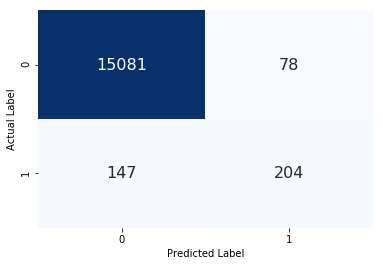

In [17]:
df_cm = pd.DataFrame(array, index=[0, 1], columns=[0, 1])
sns.heatmap(df_cm, annot=True,annot_kws={"size": 16}, cmap='Blues', fmt='g', cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.show()

# Try scaling X parameters to see if it improves accuracy
Turns out it does not help, and actually makes the model worse.  Further reading suggests that scaling is not needed for tree models.

In [18]:
# Scales everything to range of (0,1)
x = df_train[new_features].values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df = pd.DataFrame(x_scaled)

x_test = df_test[new_features].values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled_test = min_max_scaler.fit_transform(x_test)
df_test_scale = pd.DataFrame(x_scaled_test)

In [19]:
# Initialize and train our tree.
decision_tree = tree.DecisionTreeClassifier(
    criterion='entropy',
    max_features=1,
    max_depth=20,
)

decision_tree.fit(df, Y)
cross_val_score(decision_tree, df, Y, cv=10)

array([0.9865818 , 0.98813005, 0.98847411, 0.98744194, 0.98692586,
       0.98950628, 0.98726991, 0.98899019, 0.98830007, 0.98657718])

In [20]:
print('The new score is {}.'.format(decision_tree.score(df_test_scale, df_test['class'])))
y_pred = decision_tree.predict(df_test_scale)

The new score is 0.9783365570599614.


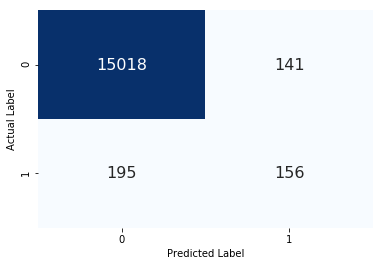

In [21]:
array = confusion_matrix(df_test['class'], y_pred)

df_cm = pd.DataFrame(array, index=[0, 1], columns=[0, 1])
sns.heatmap(df_cm, annot=True,annot_kws={"size": 16}, cmap='Blues', fmt='g', cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.show()

# Moving to using a forest

In [27]:
rfc = ensemble.RandomForestClassifier(n_estimators=10, max_depth=20)
rfc.fit(X[new_features], Y)

start_time = time.time()
cross_val_score(rfc, X[new_features], Y, cv=10)
print("--- {:.2f} seconds ---".format(time.time() - start_time))

--- 33.97 seconds ---


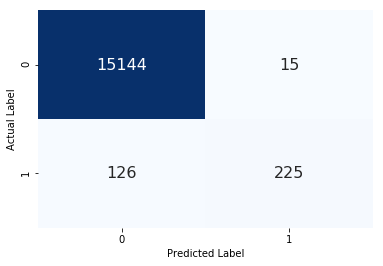

In [28]:
y_pred = rfc.predict(df_test[new_features])
array = confusion_matrix(df_test['class'], y_pred)
df_cm = pd.DataFrame(array, index=[0, 1], columns=[0, 1])
sns.heatmap(df_cm, annot=True,annot_kws={"size": 16}, cmap='Blues', fmt='g', cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.show()

Running the cross validation on the simple random forest was ~ 30 times slower than the decision tree.  This is a large computational cost.